In [5]:
from goes2go import GOES
import matplotlib.pyplot as plt
from goes2go.data import goes_nearesttime
from goes2go.data import goes_latest
from datetime import datetime, timedelta
import pandas as pd
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Function from Carpenter_Workshop: https://github.com/blaylockbk/Carpenter_Workshop
from toolbox import EasyMap, pc, ccrs

import warnings
warnings.filterwarnings("ignore")


📦 Finished downloading [1] files to [/home/michael/data/noaa-goes16/ABI-L2-MCMIPC].
📚 Finished reading [1] files into xarray.Dataset.                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   

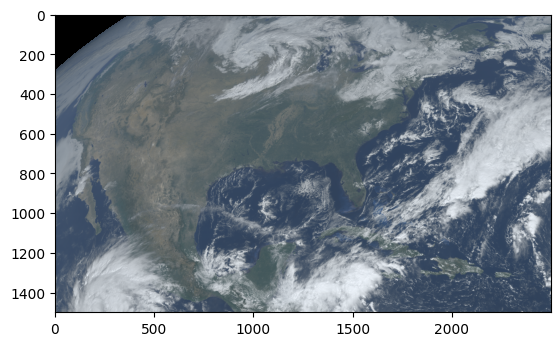

In [6]:
# Get an ABI Dataset
G = GOES().latest()

# Create RGB and plot
plt.imshow(G.rgb.TrueColor())

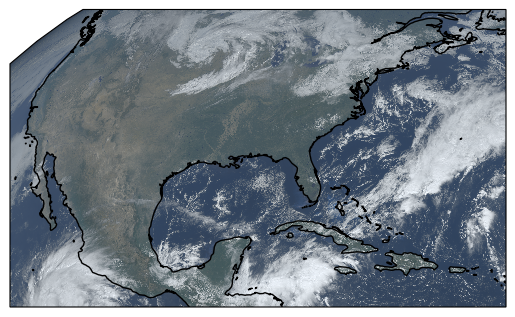

In [7]:
ax = plt.subplot(projection=G.rgb.crs)
ax.imshow(G.rgb.TrueColor(), **G.rgb.imshow_kwargs)
ax.coastlines()

In [8]:
from goes2go import GOES
import matplotlib.pyplot as plt

# Function from Carpenter_Workshop: https://github.com/blaylockbk/Carpenter_Workshop
from toolbox import EasyMap, pc, ccrs

In [9]:
G16 = goes_latest(satellite=16)
G18 = goes_latest(satellite=18)

 👮🏻‍♂️ File already exists. Do not overwrite: /home/michael/data/noaa-goes16/ABI-L2-MCMIPC/2023/291/16/OR_ABI-L2-MCMIPC-M6_G16_s20232911606172_e20232911608551_c20232911609054.nc
📦 Finished downloading [1] files to [/home/michael/data/noaa-goes16/ABI-L2-MCMIPC].
📚 Finished reading [1] files into xarray.Dataset.                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 

In [10]:
rgb_products = [i for i in dir(G16.rgb) if i[0].isupper()]
rgb_products

['AirMass',
 'AirMassTropical',
 'AirMassTropicalPac',
 'Ash',
 'DayCloudConvection',
 'DayCloudPhase',
 'DayConvection',
 'DayLandCloud',
 'DayLandCloudFire',
 'DaySnowFog',
 'DifferentialWaterVapor',
 'Dust',
 'FireTemperature',
 'NaturalColor',
 'NightFogDifference',
 'NighttimeMicrophysics',
 'NormalizedBurnRatio',
 'RocketPlume',
 'SeaSpray',
 'SplitWindowDifference',
 'SulfurDioxide',
 'TrueColor',
 'WaterVapor']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


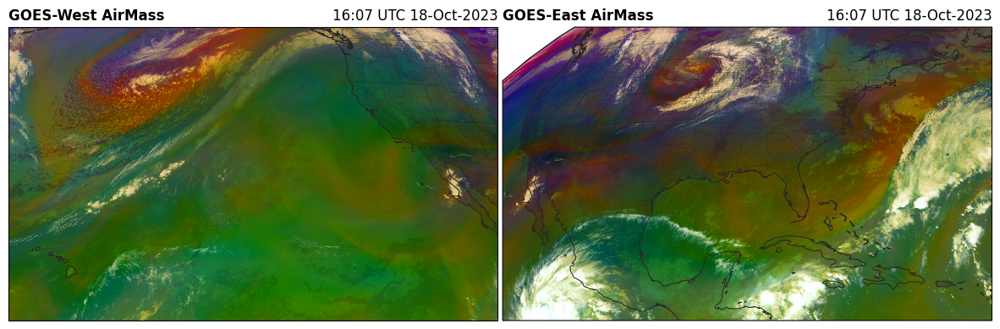

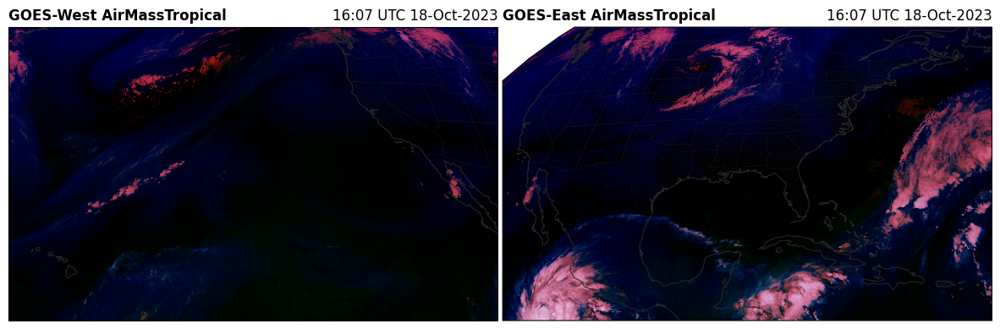

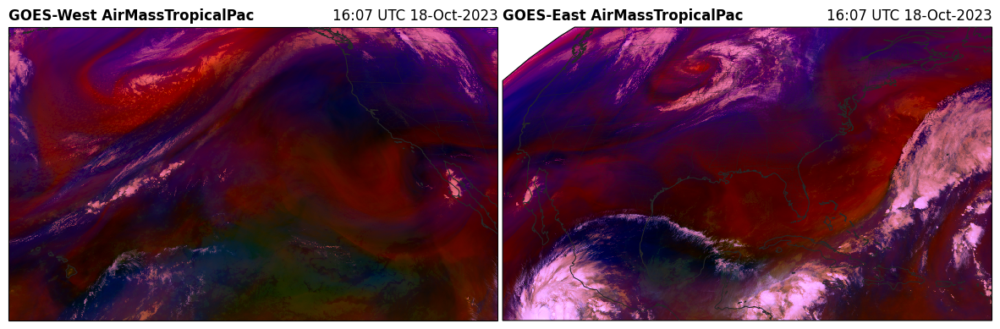

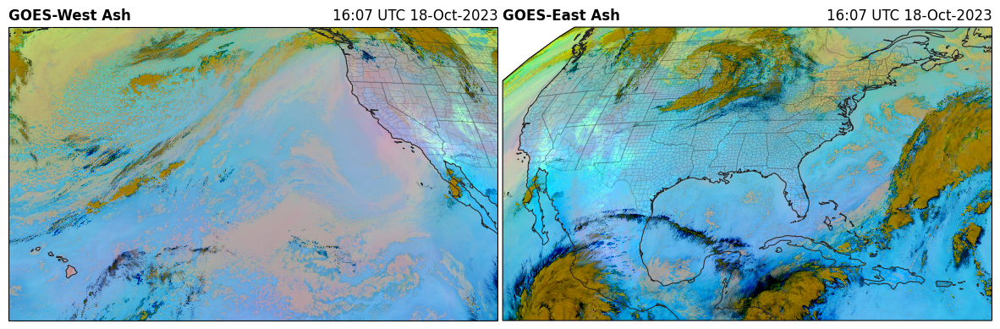

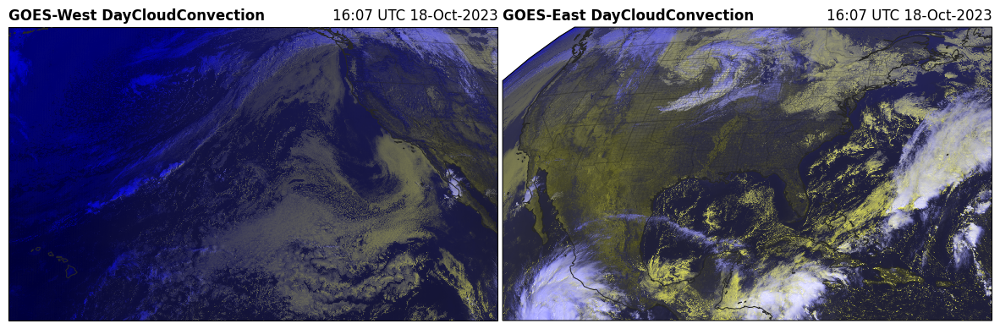

...

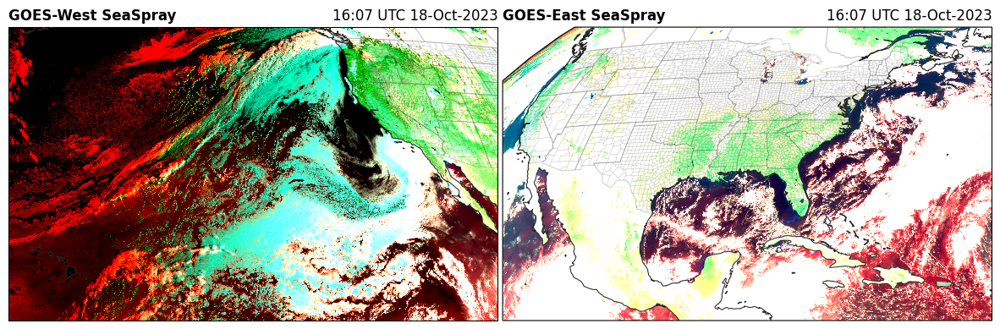

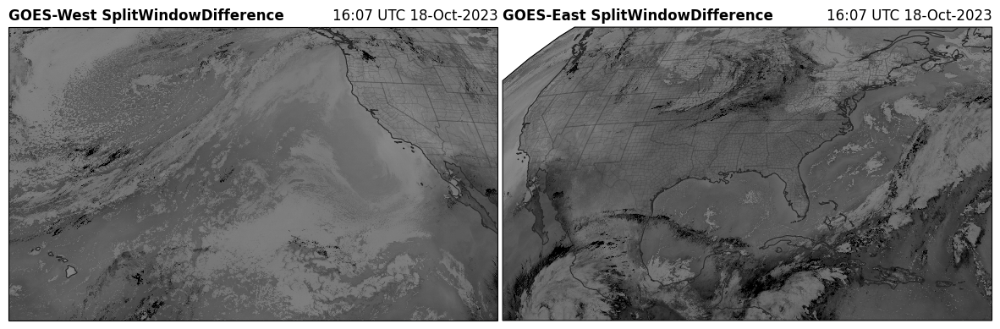

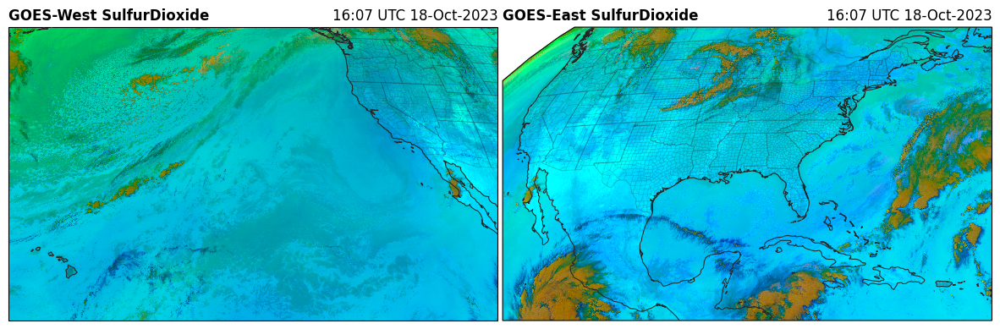

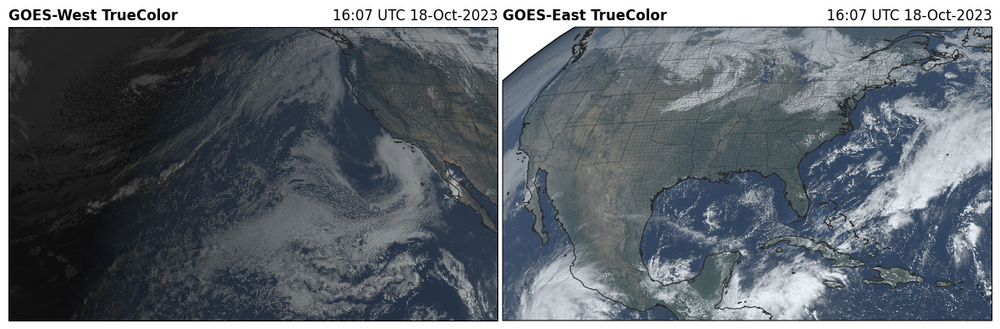

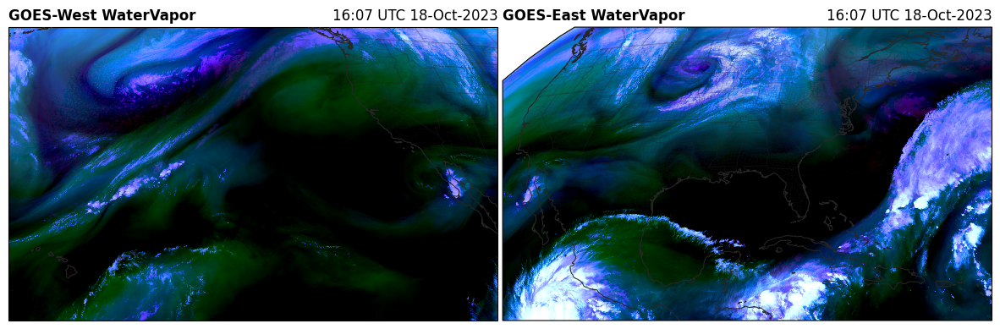

In [11]:
rgb_products = [i for i in dir(G16.rgb) if i[0].isupper()]

for product in rgb_products:

    fig = plt.figure(figsize=(15, 12))
    ax18 = fig.add_subplot(1, 2, 1, projection=G18.rgb.crs)
    ax16 = fig.add_subplot(1, 2, 2, projection=G16.rgb.crs)

    for ax, G in zip([ax18, ax16], [G18, G16]):
        RGB = getattr(G.rgb, product)()

        EasyMap("50m", ax=ax).STATES().LAND().COUNTIES()#.OCEAN()
        ax.imshow(RGB, **G.rgb.imshow_kwargs)
        ax.set_title(f"{G.orbital_slot} {product}", loc="left", fontweight="bold")
        ax.set_title(f"{G.t.dt.strftime('%H:%M UTC %d-%b-%Y').item()}", loc="right")
    plt.subplots_adjust(wspace=0.01)
    date_time_str = G.t.dt.strftime('%H:%M UTC %d-%b-%Y').item()
    plt.savefig(f"./images/{product}_{date_time_str}.png", bbox_inches="tight")